<a href="https://colab.research.google.com/github/LeonardoSer/Univ/blob/main/MIT_deepLearning/Labs/Lab1/Mio_musicGen.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%tensorflow_version 2.x
import tensorflow as tf 

import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay

# Download and import the MIT 6.S191 package
!pip install mitdeeplearning
import mitdeeplearning as mdl

#https://pypi.org/project/tqdm/
from tqdm import tqdm

# https://wiki.archlinux.org/index.php/Timidity%2B%2B
!apt-get install abcmidi timidity > /dev/null 2>&1

In [36]:
# controlliamo se stiamo usando una GPU
 # in caso non la stiamo usando cambiamo le impostazioni di Colab 
  # Runtime > Change Runtime Type > GPU
physical_devices = tf.config.list_physical_devices('GPU')
print("Num GPUs:", len(physical_devices))

Num GPUs: 1


In [37]:
# dataset
songs = mdl.lab1.load_training_data()

# esempio
example_song = songs[0]
print(example_song)

# Converte la notazione ABC in un .wav e lo ascolta
mdl.lab1.play_song(example_song)

Found 817 songs in text
X:1
T:Alexander's
Z: id:dc-hornpipe-1
M:C|
L:1/8
K:D Major
(3ABc|dAFA DFAd|fdcd FAdf|gfge fefd|(3efe (3dcB A2 (3ABc|!
dAFA DFAd|fdcd FAdf|gfge fefd|(3efe dc d2:|!
AG|FAdA FAdA|GBdB GBdB|Acec Acec|dfaf gecA|!
FAdA FAdA|GBdB GBdB|Aceg fefd|(3efe dc d2:|!


In [38]:
# mettiamo tutte le canzoni su una stringa
songs_joined = "\n\n".join(songs) 

# estraiamo l'alfabeto dei dati
vocab = sorted(set(songs_joined))
print("len dell'alfabeto: ", len(vocab))
print("\n", vocab)

len dell'alfabeto:  83

 ['\n', ' ', '!', '"', '#', "'", '(', ')', ',', '-', '.', '/', '0', '1', '2', '3', '4', '5', '6', '7', '8', '9', ':', '<', '=', '>', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z', '[', ']', '^', '_', 'a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z', '|']


In [39]:
# indicizziamo l'alfabeto
char2idx = {u:i for i, u in enumerate(vocab)}
idx2char = np.array(vocab)

vectorized_songs = np.array([char2idx[char] for char in songs_joined])

In [40]:
# Creiamo un TrainingSet per il modello, prendendo casualmente coppie di sequenze {IN, OUT}:
 # Training Set: IN = {x1, x2, x3}, OUT = {x2, x3, x4} 
  # 'seq_length' è la lunghezza delle sequenze
   # `batch_size` è il numero di sequenze

def get_batch(vectorized_songs, seq_length, batch_size):
  
  n = vectorized_songs.shape[0] - 1 # lunghezza della stringa
  idx = np.random.choice(n-seq_length, batch_size) # generiamo indici casuali per prendere le sotto-sequenze
  
  # creiamo le IN e le OUT sequences
  input_batch = [vectorized_songs[i : i+seq_length] for i in idx]
  output_batch = [vectorized_songs[i+1 : i+seq_length+1] for i in idx]

  # reshape delle sequence
   # input_batch = [array([ 1, 29, 70, 73, 64, 56, 69,  0, 26, 27]), array([76, 69, 74,  1, 70, 61,  1, 75, 63, 60])]
    # x_batch = [[ 1 29 70 73 64 56 69  0 26 27] [76 69 74  1 70 61  1 75 63 60]]
  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])

  return x_batch, y_batch

In [41]:
# funzione per la creazione dell'LSTM layer
def LSTM(rnn_units): 
  return tf.keras.layers.LSTM(
    rnn_units, 
    return_sequences=True, 
    recurrent_initializer='glorot_uniform',
    recurrent_activation='sigmoid',
    stateful=True,
  )

# Definiamo l'RNN Model
def build_model(vocab_size, embedding_dim, rnn_units, batch_size):

  # Definiamo 3 layer:
   # Layer1: Embedding -> https://machinelearningmastery.com/use-word-embedding-layers-deep-learning-keras/
    # Layer2: LSTM con rnn_units 
     # Layer3: dense layer

    embedding_layer = tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None])
    lstm_layer = LSTM(rnn_units) 
    dense_layer = tf.keras.layers.Dense(vocab_size)
    model = tf.keras.Sequential([embedding_layer, lstm_layer, dense_layer])
    
    return model

In [42]:
# Definiamo la loss function 
def compute_loss(labels, logits):  
    loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True)
    return loss

In [43]:
### Hyperparameter setting and optimization ###

# Optimization parameters:
num_training_iterations = 2000  # Increase this to train longer
batch_size = 4  # Experiment between 1 and 64
seq_length = 100  # Experiment between 50 and 500
learning_rate = 5e-3  # Experiment between 1e-5 and 1e-1

# Model parameters: 
vocab_size = len(vocab)
embedding_dim = 256 # per i caratteri 256 è un buon embedding
rnn_units = 1024  # Experiment between 1 and 2048

# file dove salvare i pesi del modello già allenato 
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")


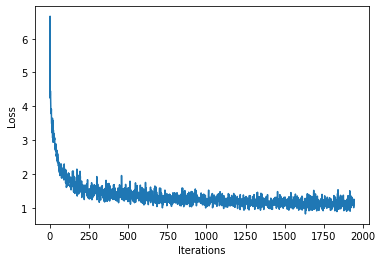

100%|██████████| 2000/2000 [00:52<00:00, 37.90it/s]


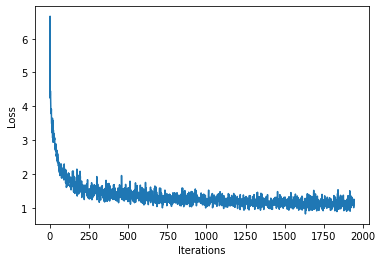

In [44]:
# Optimizer and training operation 

model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)

optimizer = tf.keras.optimizers.Adam(learning_rate) # https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/

@tf.function
def train_step(x, y): 

  # Use tf.GradientTape()
  with tf.GradientTape() as tape:
    
    # y_hat sono le predizioni
    y_hat = model(x) 
  
    loss = compute_loss(y, y_hat) 

    # Voglia il gradinete della perdita rispetto TUTTI i parametri del modello
     # con `model.trainable_variables` ce li ricaviamo tutti
    grads = tape.gradient(loss, model.trainable_variables) # TODO
  
    # passiamo il gradiente all'optimizer cosi può aggiornare il modello di conseguenza
    optimizer.apply_gradients(zip(grads, model.trainable_variables))
  return loss

##################
# Begin training!#
##################

history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): 
    tqdm._instances.clear() # clear if it exists

for iter in tqdm(range(num_training_iterations)):

    # Grab a batch and propagate it through the network
    x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
    loss = train_step(x_batch, y_batch)

    # Update the progress bar
    history.append(loss.numpy().mean())
    plotter.plot(history)

    # salviamo i pesi su file
    if iter % 100 == 0:     
        model.save_weights(checkpoint_prefix)
    
# salviamo i pesi finale dati dal training
model.save_weights(checkpoint_prefix)

In [45]:
# prediciamo una serie di note di lunghezza 'generation_lenght a partire dal carattere `start_string`
def generate_text(model, start_string, generation_length=1000):

  input_eval = [char2idx[s] for s in start_string] # TODO
  
  input_eval = tf.expand_dims(input_eval, 0) # aggiungiamo al tensore una dimensione che rappresenta il numero di input `batch dimension`

  # Empty string to store our results
  text_generated = []

  # Here batch size == 1
  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
      predictions = model(input_eval)
      
      # Remove the batch dimension
      predictions = tf.squeeze(predictions, 0) # togliamo la dimensione di troppo
      
      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy() 
      
      # passiamo la predizione attuale come hidden state, cosi ne terremo conto alla prossima iterazione
      input_eval = tf.expand_dims([predicted_id], 0)
      
      text_generated.append(idx2char[predicted_id]) 
    
  return (start_string + ''.join(text_generated))

In [47]:
# Play back generated songs 

# dobbiamo ricostruire il modello dopo il training, poichè  dobbiamo dargli un singolo input e predirre un singolo output
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1) # TODO

# ricarichiamo i pesi salvati 
model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

model.summary()

generated_text = generate_text(model, start_string="X", generation_length=1000)
generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs): 
  # Synthesize the waveform from a song
  waveform = mdl.lab1.play_song(song)

  # If its a valid song (correct syntax), lets play it! 
  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

  2%|▏         | 21/1000 [00:00<00:04, 208.69it/s]

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_6 (Embedding)      (1, None, 256)            21248     
_________________________________________________________________
lstm_5 (LSTM)                (1, None, 1024)           5246976   
_________________________________________________________________
dense_5 (Dense)              (1, None, 83)             85075     
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


100%|██████████| 1000/1000 [00:04<00:00, 216.90it/s]


Found 3 songs in text
Generated song 0


Generated song 1


Generated song 2
